# IBM HR analytics

## Descriptive data analysis

In [1]:
#Import of the particular libraries 
import math
import numpy as np
import os 
import pandas as pd

In [2]:
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from catboost import CatBoostClassifier

In [3]:
from evidently.dashboard import Dashboard
from evidently.tabs import DriftTab, ClassificationPerformanceTab, ProbClassificationPerformanceTab, CatTargetDriftTab

In [4]:
#Import of the visualization libraries 
import matplotlib
import matplotlib.pyplot as plt

red = "#ed0400"
grey = "#4d4d4d"
evidently_cmap = matplotlib.colors.ListedColormap([red, grey])

%matplotlib inline

## Source data

In [5]:
DATA_DIR = "datasets/ibm-hr-analytics//" #full path to directory with the input data 
              
dataset_path = os.path.join(DATA_DIR, "WA_Fn-UseC_-HR-Employee-Attrition.csv")

In [6]:
dataset = pd.read_csv(dataset_path, sep = ',', header = 0)

In [7]:
dataset.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [8]:
dataset.shape

(1470, 35)

In [9]:
dataset.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [10]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [11]:
#check if EmployeeNumber is a correct index
dataset.EmployeeNumber.nunique() == dataset.shape[0]

True

In [12]:
#constant features
print(dataset.EmployeeCount.nunique())
print(dataset.StandardHours.nunique())
print(dataset.Over18.nunique())

1
1
1


## Feature engineering

In [13]:
target_name = 'Attrition'

In [14]:
numerique_features = ['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EnvironmentSatisfaction',
                      'HourlyRate', 'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
                      'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike', 'PerformanceRating',
                      'RelationshipSatisfaction','StockOptionLevel', 'TotalWorkingYears',
                      'TrainingTimesLastYear', 'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
                      'YearsSinceLastPromotion', 'YearsWithCurrManager'
                     ]

In [15]:
categorical_features = ['BusinessTravel', 'Department', 'EducationField', 'Gender',
                        'JobRole', 'MaritalStatus', 'OverTime'
                       ]

In [16]:
processed_dataset = dataset.copy(deep = True)

#### Drop constant features

In [17]:
processed_dataset.drop(columns = ['EmployeeCount', 'StandardHours', 'Over18'], inplace = True)

#### BusinessTravel

In [18]:
processed_dataset.BusinessTravel.value_counts()

Travel_Rarely        1043
Travel_Frequently     277
Non-Travel            150
Name: BusinessTravel, dtype: int64

In [19]:
business_travel_dummies = pd.get_dummies(processed_dataset.BusinessTravel, prefix = 'b_travel')
processed_dataset = pd.concat([processed_dataset, business_travel_dummies], axis=1)

#### Department

In [20]:
dataset.Department.value_counts()

Research & Development    961
Sales                     446
Human Resources            63
Name: Department, dtype: int64

In [21]:
department_dummies = pd.get_dummies(processed_dataset.Department, prefix = 'department')
processed_dataset = pd.concat([processed_dataset, department_dummies], axis=1)

#### EducationField

In [22]:
dataset.EducationField.value_counts()

Life Sciences       606
Medical             464
Marketing           159
Technical Degree    132
Other                82
Human Resources      27
Name: EducationField, dtype: int64

In [23]:
edu_field_dummies = pd.get_dummies(processed_dataset.Department, prefix = 'edu_field')
processed_dataset = pd.concat([processed_dataset, edu_field_dummies], axis=1)

#### Gender

In [24]:
dataset.Gender.value_counts()

Male      882
Female    588
Name: Gender, dtype: int64

In [25]:
processed_dataset['gender_bin'] = processed_dataset.Gender.apply(
    lambda x : 0 if x == 'Male' else 1 if x == 'Female' else -1)

#### JobRole

In [26]:
dataset.JobRole.value_counts()

Sales Executive              326
Research Scientist           292
Laboratory Technician        259
Manufacturing Director       145
Healthcare Representative    131
Manager                      102
Sales Representative          83
Research Director             80
Human Resources               52
Name: JobRole, dtype: int64

In [27]:
job_role_dummies = pd.get_dummies(processed_dataset.JobRole, prefix = 'job_role')
processed_dataset = pd.concat([processed_dataset, job_role_dummies], axis=1)

#### MaritalStatus

In [28]:
dataset.MaritalStatus.value_counts()

Married     673
Single      470
Divorced    327
Name: MaritalStatus, dtype: int64

In [29]:
marital_dummies = pd.get_dummies(processed_dataset.MaritalStatus, prefix = 'marital')
processed_dataset = pd.concat([processed_dataset, marital_dummies], axis=1)

#### OverTime

In [30]:
dataset.OverTime.value_counts()

No     1054
Yes     416
Name: OverTime, dtype: int64

In [31]:
overtime_dummies = pd.get_dummies(processed_dataset.OverTime, prefix = 'overtime')
processed_dataset = pd.concat([processed_dataset, overtime_dummies], axis=1)

In [32]:
#drop initial categorical features
processed_dataset.drop(columns = categorical_features, inplace = True)

### Target

In [33]:
processed_dataset['target'] = processed_dataset.Attrition.apply(
    lambda x : 0 if x == 'No' else 1 if x == 'Yes' else -1)

## Dataset generation

In [34]:
processed_dataset.columns

Index(['Age', 'Attrition', 'DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'b_travel_Non-Travel',
       'b_travel_Travel_Frequently', 'b_travel_Travel_Rarely',
       'department_Human Resources', 'department_Research & Development',
       'department_Sales', 'edu_field_Human Resources',
       'edu_field_Research & Development', 'edu_field_Sales', 'gender_bin',
       'job_role_Healthcare Representative', 'job_role_Human Resources',
       'job_role_Laboratory Technician', 'job_role_Manager',
       'job_role_Manufacturing Director', 'j

In [35]:
features = ['Age','DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager', 'b_travel_Non-Travel',
       'b_travel_Travel_Frequently', 'b_travel_Travel_Rarely',
       'department_Human Resources', 'department_Research & Development',
       'department_Sales', 'edu_field_Human Resources',
       'edu_field_Research & Development', 'edu_field_Sales', 'gender_bin',
       'job_role_Healthcare Representative', 'job_role_Human Resources',
       'job_role_Laboratory Technician', 'job_role_Manager',
       'job_role_Manufacturing Director', 'job_role_Research Director',
       'job_role_Research Scientist', 'job_role_Sales Executive',
       'job_role_Sales Representative', 'marital_Divorced', 'marital_Married',
       'marital_Single', 'overtime_No', 'overtime_Yes',]

In [36]:
processed_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 50 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   Age                                 1470 non-null   int64 
 1   Attrition                           1470 non-null   object
 2   DailyRate                           1470 non-null   int64 
 3   DistanceFromHome                    1470 non-null   int64 
 4   Education                           1470 non-null   int64 
 5   EmployeeNumber                      1470 non-null   int64 
 6   EnvironmentSatisfaction             1470 non-null   int64 
 7   HourlyRate                          1470 non-null   int64 
 8   JobInvolvement                      1470 non-null   int64 
 9   JobLevel                            1470 non-null   int64 
 10  JobSatisfaction                     1470 non-null   int64 
 11  MonthlyIncome                       1470 non-null   int6

#### Train & Holdout Test Split

In [37]:
from sklearn.model_selection import train_test_split

In [38]:
RANDOM_STATE = 1603

train_data, test_data, train_y, test_y = train_test_split(processed_dataset[features], processed_dataset.target,
                                                   random_state = RANDOM_STATE, test_size = 0.25,
                                                   stratify = processed_dataset.target)

In [39]:
train_y.value_counts()

0    924
1    178
Name: target, dtype: int64

In [40]:
test_y.value_counts()

0    309
1     59
Name: target, dtype: int64

## Modeling

In [41]:
def get_precison_recall_table(target, probs, step_size = 0.05):
    
    binded = list(zip(target, probs))
    binded.sort(key = lambda item: item[1], reverse = True)
    
    data_size = len(binded)
    target_class_size = sum(list(map(lambda x: x[0], binded)))

    result = pd.DataFrame(columns = ['Top(%)', 'Count', 'TP', 'FP', 'precision', 'recall'])

    offset = int(data_size*step_size)
    for step in np.arange(offset, data_size + offset, offset):
        count = min(step, data_size)
        top = round(100.0*min(step, data_size)/data_size, 1)
        tp = sum(list(map(lambda x: x[0], binded[:min(step, data_size)])))
        fp = count - tp
        precision = round(100.0*tp/count, 1)
        recall = round(100.0*tp/target_class_size, 1)
        #print(top, count, tp, fp, precision, recall)

        result = result.append({'Top(%)' : top, 
                       'Count' : count, 
                       'TP' : tp, 
                       'FP' : fp, 
                       'precision' : precision, 
                       'recall' : recall}, ignore_index = True)

    return result

### Baseline

In [42]:
rf = RandomForestClassifier(n_estimators=500, n_jobs = -1, random_state = 11)

In [43]:
rf.fit(train_data[features], train_y)

RandomForestClassifier(n_estimators=500, n_jobs=-1, random_state=11)

In [44]:
metrics.roc_auc_score(test_y, list(map(lambda x : x[1], rf.predict_proba(test_data[features]))))

0.7948549174483023

In [45]:
print(metrics.classification_report(test_y, rf.predict(test_data[features]), digits=3))

              precision    recall  f1-score   support

           0      0.853     0.994     0.918       309
           1      0.750     0.102     0.179        59

    accuracy                          0.851       368
   macro avg      0.801     0.548     0.548       368
weighted avg      0.836     0.851     0.799       368



In [46]:
get_precison_recall_table(test_y, list(map(lambda x : x[1], rf.predict_proba(test_data[features]))),
                          step_size= 0.05)

,Top(%),Count,TP,FP,precision,recall
0,4.9,18.0,12.0,6.0,66.7,20.3
1,9.8,36.0,20.0,16.0,55.6,33.9
2,14.7,54.0,27.0,27.0,50.0,45.8
3,19.6,72.0,31.0,41.0,43.1,52.5
4,24.5,90.0,36.0,54.0,40.0,61.0
5,29.3,108.0,40.0,68.0,37.0,67.8
6,34.2,126.0,42.0,84.0,33.3,71.2
7,39.1,144.0,43.0,101.0,29.9,72.9
8,44.0,162.0,48.0,114.0,29.6,81.4
9,48.9,180.0,51.0,129.0,28.3,86.4


### Baseline Classification Report

In [47]:
train_probas = pd.DataFrame(rf.predict_proba(train_data[features]))
train_probas.columns = ['no', 'yes']
test_probas = pd.DataFrame(rf.predict_proba(test_data[features]))
test_probas.columns = ['no', 'yes']

In [48]:
train_data.reset_index(inplace=True, drop=True)
train_data['Attrition'] = ['no' if x == 0 else 'yes' for x in train_y]
rf_merged_train = pd.concat([train_data, train_probas], axis = 1)

test_data.reset_index(inplace=True, drop=True)
test_data['Attrition'] = ['no' if x == 0 else 'yes' for x in test_y]
rf_merged_test = pd.concat([test_data, test_probas], axis = 1)

In [49]:
column_mapping = {}

column_mapping['target'] = 'Attrition'
column_mapping['prediction'] = ['yes', 'no']

column_mapping['numerical_features'] = ['Age','DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager']
column_mapping['categorical_features'] = ['b_travel_Non-Travel',
       'b_travel_Travel_Frequently', 'b_travel_Travel_Rarely',
       'department_Human Resources', 'department_Research & Development',
       'department_Sales', 'edu_field_Human Resources',
       'edu_field_Research & Development', 'edu_field_Sales', 'gender_bin',
       'job_role_Healthcare Representative', 'job_role_Human Resources',
       'job_role_Laboratory Technician', 'job_role_Manager',
       'job_role_Manufacturing Director', 'job_role_Research Director',
       'job_role_Research Scientist', 'job_role_Sales Executive',
       'job_role_Sales Representative', 'marital_Divorced', 'marital_Married',
       'marital_Single', 'overtime_No', 'overtime_Yes']

In [50]:
report = Dashboard(rf_merged_train, rf_merged_test, column_mapping = column_mapping, 
                       tabs=[ProbClassificationPerformanceTab])
report.show()

In [51]:
report.save('reports/ibm_hr_attrition_baseline_performance.html')

## Better model

In [52]:
cat = CatBoostClassifier(random_state= 11, iterations=1600, learning_rate=0.008, class_weights = {0:1, 1:6})

In [53]:
cat.fit(train_data[features], train_y)

0:	learn: 0.6898542	total: 65.1ms	remaining: 1m 44s
1:	learn: 0.6885238	total: 83.8ms	remaining: 1m 6s
2:	learn: 0.6861067	total: 105ms	remaining: 55.7s
3:	learn: 0.6831381	total: 131ms	remaining: 52.1s
4:	learn: 0.6800190	total: 135ms	remaining: 43.1s
5:	learn: 0.6774803	total: 140ms	remaining: 37.2s
6:	learn: 0.6740947	total: 147ms	remaining: 33.4s
7:	learn: 0.6705166	total: 150ms	remaining: 29.8s
8:	learn: 0.6682043	total: 153ms	remaining: 27.1s
9:	learn: 0.6651214	total: 157ms	remaining: 24.9s
10:	learn: 0.6622448	total: 160ms	remaining: 23.2s
11:	learn: 0.6595397	total: 167ms	remaining: 22.1s
12:	learn: 0.6573705	total: 172ms	remaining: 21s
13:	learn: 0.6555735	total: 175ms	remaining: 19.9s
14:	learn: 0.6527002	total: 178ms	remaining: 18.8s
15:	learn: 0.6508166	total: 182ms	remaining: 18s
16:	learn: 0.6473069	total: 184ms	remaining: 17.2s
17:	learn: 0.6454038	total: 187ms	remaining: 16.4s
18:	learn: 0.6436150	total: 190ms	remaining: 15.8s
19:	learn: 0.6413638	total: 193ms	remainin

165:	learn: 0.4623029	total: 849ms	remaining: 7.33s
166:	learn: 0.4614066	total: 854ms	remaining: 7.33s
167:	learn: 0.4605523	total: 859ms	remaining: 7.32s
168:	learn: 0.4597796	total: 862ms	remaining: 7.3s
169:	learn: 0.4587683	total: 871ms	remaining: 7.32s
170:	learn: 0.4577834	total: 904ms	remaining: 7.55s
171:	learn: 0.4568386	total: 916ms	remaining: 7.6s
172:	learn: 0.4559663	total: 929ms	remaining: 7.67s
173:	learn: 0.4549375	total: 935ms	remaining: 7.66s
174:	learn: 0.4540637	total: 938ms	remaining: 7.64s
175:	learn: 0.4533150	total: 942ms	remaining: 7.62s
176:	learn: 0.4526356	total: 945ms	remaining: 7.6s
177:	learn: 0.4511821	total: 948ms	remaining: 7.57s
178:	learn: 0.4500344	total: 951ms	remaining: 7.55s
179:	learn: 0.4495246	total: 954ms	remaining: 7.53s
180:	learn: 0.4483727	total: 957ms	remaining: 7.5s
181:	learn: 0.4476850	total: 960ms	remaining: 7.48s
182:	learn: 0.4470228	total: 963ms	remaining: 7.45s
183:	learn: 0.4460082	total: 965ms	remaining: 7.43s
184:	learn: 0.44

363:	learn: 0.3447160	total: 1.83s	remaining: 6.22s
364:	learn: 0.3442049	total: 1.84s	remaining: 6.22s
365:	learn: 0.3437263	total: 1.84s	remaining: 6.21s
366:	learn: 0.3432501	total: 1.85s	remaining: 6.21s
367:	learn: 0.3428339	total: 1.86s	remaining: 6.22s
368:	learn: 0.3424288	total: 1.87s	remaining: 6.23s
369:	learn: 0.3421470	total: 1.87s	remaining: 6.22s
370:	learn: 0.3415857	total: 1.88s	remaining: 6.22s
371:	learn: 0.3410508	total: 1.88s	remaining: 6.21s
372:	learn: 0.3405349	total: 1.88s	remaining: 6.2s
373:	learn: 0.3401404	total: 1.89s	remaining: 6.19s
374:	learn: 0.3397235	total: 1.89s	remaining: 6.17s
375:	learn: 0.3392768	total: 1.89s	remaining: 6.16s
376:	learn: 0.3387930	total: 1.9s	remaining: 6.15s
377:	learn: 0.3384294	total: 1.9s	remaining: 6.14s
378:	learn: 0.3379134	total: 1.9s	remaining: 6.13s
379:	learn: 0.3376725	total: 1.91s	remaining: 6.12s
380:	learn: 0.3373614	total: 1.91s	remaining: 6.11s
381:	learn: 0.3368737	total: 1.91s	remaining: 6.1s
382:	learn: 0.336

526:	learn: 0.2830595	total: 2.62s	remaining: 5.33s
527:	learn: 0.2826571	total: 2.63s	remaining: 5.34s
528:	learn: 0.2823716	total: 2.65s	remaining: 5.37s
529:	learn: 0.2817809	total: 2.67s	remaining: 5.38s
530:	learn: 0.2812561	total: 2.67s	remaining: 5.38s
531:	learn: 0.2809045	total: 2.68s	remaining: 5.38s
532:	learn: 0.2804062	total: 2.68s	remaining: 5.37s
533:	learn: 0.2799768	total: 2.69s	remaining: 5.36s
534:	learn: 0.2795789	total: 2.69s	remaining: 5.36s
535:	learn: 0.2792029	total: 2.69s	remaining: 5.35s
536:	learn: 0.2788694	total: 2.7s	remaining: 5.34s
537:	learn: 0.2785779	total: 2.7s	remaining: 5.33s
538:	learn: 0.2782958	total: 2.71s	remaining: 5.33s
539:	learn: 0.2778366	total: 2.71s	remaining: 5.32s
540:	learn: 0.2775577	total: 2.71s	remaining: 5.31s
541:	learn: 0.2773148	total: 2.72s	remaining: 5.3s
542:	learn: 0.2770481	total: 2.82s	remaining: 5.49s
543:	learn: 0.2767063	total: 2.84s	remaining: 5.51s
544:	learn: 0.2763010	total: 2.84s	remaining: 5.5s
545:	learn: 0.27

699:	learn: 0.2329671	total: 3.8s	remaining: 4.88s
700:	learn: 0.2327516	total: 3.8s	remaining: 4.88s
701:	learn: 0.2323838	total: 3.81s	remaining: 4.87s
702:	learn: 0.2322496	total: 3.81s	remaining: 4.87s
703:	learn: 0.2320436	total: 3.82s	remaining: 4.86s
704:	learn: 0.2317782	total: 3.83s	remaining: 4.86s
705:	learn: 0.2315734	total: 3.83s	remaining: 4.85s
706:	learn: 0.2311429	total: 3.84s	remaining: 4.86s
707:	learn: 0.2309915	total: 3.85s	remaining: 4.85s
708:	learn: 0.2306840	total: 3.86s	remaining: 4.86s
709:	learn: 0.2305080	total: 3.87s	remaining: 4.86s
710:	learn: 0.2303019	total: 3.88s	remaining: 4.85s
711:	learn: 0.2300164	total: 3.89s	remaining: 4.85s
712:	learn: 0.2297179	total: 3.89s	remaining: 4.84s
713:	learn: 0.2292131	total: 3.9s	remaining: 4.84s
714:	learn: 0.2290967	total: 3.9s	remaining: 4.83s
715:	learn: 0.2290035	total: 3.91s	remaining: 4.82s
716:	learn: 0.2287680	total: 3.91s	remaining: 4.82s
717:	learn: 0.2283819	total: 3.92s	remaining: 4.81s
718:	learn: 0.22

882:	learn: 0.1886463	total: 4.55s	remaining: 3.7s
883:	learn: 0.1885548	total: 4.55s	remaining: 3.69s
884:	learn: 0.1883229	total: 4.56s	remaining: 3.68s
885:	learn: 0.1881003	total: 4.56s	remaining: 3.67s
886:	learn: 0.1879071	total: 4.57s	remaining: 3.67s
887:	learn: 0.1877294	total: 4.57s	remaining: 3.66s
888:	learn: 0.1875486	total: 4.57s	remaining: 3.66s
889:	learn: 0.1872650	total: 4.57s	remaining: 3.65s
890:	learn: 0.1868689	total: 4.58s	remaining: 3.64s
891:	learn: 0.1865130	total: 4.58s	remaining: 3.63s
892:	learn: 0.1862504	total: 4.58s	remaining: 3.63s
893:	learn: 0.1860268	total: 4.59s	remaining: 3.62s
894:	learn: 0.1858632	total: 4.59s	remaining: 3.61s
895:	learn: 0.1856662	total: 4.59s	remaining: 3.61s
896:	learn: 0.1854835	total: 4.6s	remaining: 3.6s
897:	learn: 0.1851860	total: 4.6s	remaining: 3.6s
898:	learn: 0.1849577	total: 4.6s	remaining: 3.59s
899:	learn: 0.1847473	total: 4.61s	remaining: 3.58s
900:	learn: 0.1845072	total: 4.61s	remaining: 3.58s
901:	learn: 0.1842

1066:	learn: 0.1488189	total: 5.28s	remaining: 2.64s
1067:	learn: 0.1485436	total: 5.28s	remaining: 2.63s
1068:	learn: 0.1484463	total: 5.29s	remaining: 2.63s
1069:	learn: 0.1482412	total: 5.29s	remaining: 2.62s
1070:	learn: 0.1479810	total: 5.3s	remaining: 2.62s
1071:	learn: 0.1478641	total: 5.3s	remaining: 2.61s
1072:	learn: 0.1476545	total: 5.3s	remaining: 2.6s
1073:	learn: 0.1474913	total: 5.31s	remaining: 2.6s
1074:	learn: 0.1473702	total: 5.31s	remaining: 2.59s
1075:	learn: 0.1472387	total: 5.31s	remaining: 2.59s
1076:	learn: 0.1470031	total: 5.32s	remaining: 2.58s
1077:	learn: 0.1468475	total: 5.32s	remaining: 2.58s
1078:	learn: 0.1467407	total: 5.32s	remaining: 2.57s
1079:	learn: 0.1466252	total: 5.33s	remaining: 2.56s
1080:	learn: 0.1464253	total: 5.33s	remaining: 2.56s
1081:	learn: 0.1462914	total: 5.34s	remaining: 2.56s
1082:	learn: 0.1461495	total: 5.34s	remaining: 2.55s
1083:	learn: 0.1458953	total: 5.35s	remaining: 2.55s
1084:	learn: 0.1457541	total: 5.35s	remaining: 2.54

1252:	learn: 0.1165315	total: 6.04s	remaining: 1.67s
1253:	learn: 0.1163865	total: 6.04s	remaining: 1.67s
1254:	learn: 0.1162493	total: 6.04s	remaining: 1.66s
1255:	learn: 0.1161338	total: 6.04s	remaining: 1.66s
1256:	learn: 0.1159660	total: 6.05s	remaining: 1.65s
1257:	learn: 0.1157968	total: 6.05s	remaining: 1.65s
1258:	learn: 0.1156827	total: 6.05s	remaining: 1.64s
1259:	learn: 0.1155972	total: 6.06s	remaining: 1.64s
1260:	learn: 0.1153946	total: 6.06s	remaining: 1.63s
1261:	learn: 0.1152745	total: 6.07s	remaining: 1.62s
1262:	learn: 0.1150916	total: 6.07s	remaining: 1.62s
1263:	learn: 0.1149467	total: 6.07s	remaining: 1.61s
1264:	learn: 0.1148052	total: 6.08s	remaining: 1.61s
1265:	learn: 0.1146230	total: 6.08s	remaining: 1.6s
1266:	learn: 0.1144639	total: 6.08s	remaining: 1.6s
1267:	learn: 0.1143754	total: 6.09s	remaining: 1.59s
1268:	learn: 0.1143145	total: 6.09s	remaining: 1.59s
1269:	learn: 0.1142329	total: 6.09s	remaining: 1.58s
1270:	learn: 0.1141749	total: 6.09s	remaining: 1

1413:	learn: 0.0954969	total: 6.6s	remaining: 868ms
1414:	learn: 0.0953881	total: 6.61s	remaining: 864ms
1415:	learn: 0.0952450	total: 6.61s	remaining: 859ms
1416:	learn: 0.0950866	total: 6.61s	remaining: 854ms
1417:	learn: 0.0949707	total: 6.61s	remaining: 849ms
1418:	learn: 0.0948924	total: 6.62s	remaining: 844ms
1419:	learn: 0.0947698	total: 6.62s	remaining: 839ms
1420:	learn: 0.0946341	total: 6.62s	remaining: 834ms
1421:	learn: 0.0944977	total: 6.63s	remaining: 830ms
1422:	learn: 0.0943804	total: 6.63s	remaining: 825ms
1423:	learn: 0.0942687	total: 6.64s	remaining: 820ms
1424:	learn: 0.0941383	total: 6.64s	remaining: 816ms
1425:	learn: 0.0939982	total: 6.64s	remaining: 811ms
1426:	learn: 0.0938898	total: 6.65s	remaining: 806ms
1427:	learn: 0.0937334	total: 6.65s	remaining: 801ms
1428:	learn: 0.0935906	total: 6.65s	remaining: 796ms
1429:	learn: 0.0934439	total: 6.66s	remaining: 792ms
1430:	learn: 0.0933005	total: 6.66s	remaining: 787ms
1431:	learn: 0.0932043	total: 6.66s	remaining: 

1574:	learn: 0.0788325	total: 7.17s	remaining: 114ms
1575:	learn: 0.0787543	total: 7.17s	remaining: 109ms
1576:	learn: 0.0786505	total: 7.18s	remaining: 105ms
1577:	learn: 0.0785578	total: 7.18s	remaining: 100ms
1578:	learn: 0.0785099	total: 7.18s	remaining: 95.5ms
1579:	learn: 0.0784281	total: 7.19s	remaining: 91ms
1580:	learn: 0.0783044	total: 7.19s	remaining: 86.4ms
1581:	learn: 0.0782169	total: 7.2s	remaining: 81.9ms
1582:	learn: 0.0781629	total: 7.2s	remaining: 77.3ms
1583:	learn: 0.0781124	total: 7.2s	remaining: 72.8ms
1584:	learn: 0.0780424	total: 7.21s	remaining: 68.2ms
1585:	learn: 0.0779296	total: 7.21s	remaining: 63.6ms
1586:	learn: 0.0778333	total: 7.21s	remaining: 59.1ms
1587:	learn: 0.0777410	total: 7.21s	remaining: 54.5ms
1588:	learn: 0.0776028	total: 7.22s	remaining: 50ms
1589:	learn: 0.0775046	total: 7.22s	remaining: 45.4ms
1590:	learn: 0.0773877	total: 7.22s	remaining: 40.9ms
1591:	learn: 0.0772890	total: 7.23s	remaining: 36.3ms
1592:	learn: 0.0771854	total: 7.23s	rem

In [54]:
metrics.accuracy_score(test_y, cat.predict(test_data[features]))

0.8804347826086957

In [55]:
metrics.roc_auc_score(test_y, [ x[1] for x in cat.predict_proba(test_data[features])])

0.8034666227853656

In [56]:
print(metrics.classification_report(test_y, cat.predict(test_data[features]), digits=3))

              precision    recall  f1-score   support

           0      0.903     0.961     0.931       309
           1      0.692     0.458     0.551        59

    accuracy                          0.880       368
   macro avg      0.798     0.709     0.741       368
weighted avg      0.869     0.880     0.870       368



In [57]:
get_precison_recall_table(test_y, list(map(lambda x : x[1], cat.predict_proba(test_data[features]))),
                          step_size= 0.05)

,Top(%),Count,TP,FP,precision,recall
0,4.9,18.0,14.0,4.0,77.8,23.7
1,9.8,36.0,25.0,11.0,69.4,42.4
2,14.7,54.0,32.0,22.0,59.3,54.2
3,19.6,72.0,36.0,36.0,50.0,61.0
4,24.5,90.0,39.0,51.0,43.3,66.1
5,29.3,108.0,41.0,67.0,38.0,69.5
6,34.2,126.0,44.0,82.0,34.9,74.6
7,39.1,144.0,47.0,97.0,32.6,79.7
8,44.0,162.0,47.0,115.0,29.0,79.7
9,48.9,180.0,48.0,132.0,26.7,81.4


In [58]:
train_probas = pd.DataFrame(cat.predict_proba(train_data[features]))
train_probas.columns = ['no', 'yes']
test_probas = pd.DataFrame(cat.predict_proba(test_data[features]))
test_probas.columns = ['no', 'yes']

In [59]:
train_data.reset_index(inplace=True, drop=True)
train_data['target'] = ['no' if x == 0 else 'yes' for x in train_y]
cat_merged_train = pd.concat([train_data, train_probas], axis = 1)

test_data.reset_index(inplace=True, drop=True)
test_data['target'] = ['no' if x == 0 else 'yes' for x in test_y]
cat_merged_test = pd.concat([test_data, test_probas], axis = 1)

In [60]:
column_mapping = {}

column_mapping['target'] = 'Attrition'
column_mapping['prediction'] = ['yes', 'no']

column_mapping['numerical_features'] = ['Age','DailyRate', 'DistanceFromHome', 'Education',
       'EmployeeNumber', 'EnvironmentSatisfaction', 'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 'RelationshipSatisfaction', 'StockOptionLevel',
       'TotalWorkingYears', 'TrainingTimesLastYear', 'WorkLifeBalance',
       'YearsAtCompany', 'YearsInCurrentRole', 'YearsSinceLastPromotion',
       'YearsWithCurrManager']
column_mapping['categorical_features'] = ['b_travel_Non-Travel',
       'b_travel_Travel_Frequently', 'b_travel_Travel_Rarely',
       'department_Human Resources', 'department_Research & Development',
       'department_Sales', 'edu_field_Human Resources',
       'edu_field_Research & Development', 'edu_field_Sales', 'gender_bin',
       'job_role_Healthcare Representative', 'job_role_Human Resources',
       'job_role_Laboratory Technician', 'job_role_Manager',
       'job_role_Manufacturing Director', 'job_role_Research Director',
       'job_role_Research Scientist', 'job_role_Sales Executive',
       'job_role_Sales Representative', 'marital_Divorced', 'marital_Married',
       'marital_Single', 'overtime_No', 'overtime_Yes']

In [61]:
model_report = Dashboard(cat_merged_train, cat_merged_test, column_mapping = column_mapping, 
                       tabs=[ProbClassificationPerformanceTab])
model_report.show()

In [62]:
model_report.save('reports/ibm_hr_attrition_better_model_performance.html')

## Models comparison

In [63]:
comparison_report = Dashboard(rf_merged_test, cat_merged_test, column_mapping = column_mapping, 
                       tabs=[ProbClassificationPerformanceTab])
comparison_report.show()

In [ ]:
comparison_report.save('reports/ibm_hr_attrition_model_comparison.html')

## Segments comparison

In [ ]:
'HourlyRate',
       'JobInvolvement', 'JobLevel', 'JobSatisfaction', 'MonthlyIncome',
       'MonthlyRate', 'NumCompaniesWorked', 'PercentSalaryHike',
       'PerformanceRating', 
    'department_Human Resources', 'department_Research & Development',
       'department_Sales', 
        'Education'

<AxesSubplot:>

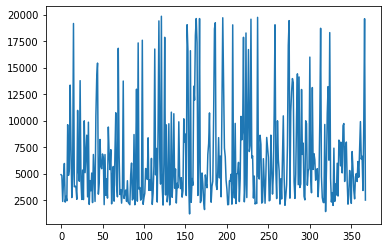

In [79]:
cat_merged_test.MonthlyIncome.plot()

In [91]:
cat_merged_test.JobLevel.value_counts()

1    135
2    131
3     59
4     24
5     19
Name: JobLevel, dtype: int64

In [94]:
segments_report = Dashboard(cat_merged_test[cat_merged_test['JobLevel'] <= 2], 
                              cat_merged_test[cat_merged_test['JobLevel'] > 2], 
                              column_mapping = column_mapping, 
                              tabs=[ProbClassificationPerformanceTab])
segments_report.show()

#### segments_report.save('reports/ibm_hr_attrition_segments_StockOptionLevel_3.html')

### Probabilyty and target with baselines

In [122]:
np.random.seed(1)

cat_probs = list(map(lambda x : x[1], cat.predict_proba(test_data[features])))

fig = go.Figure()

#RANDOM CHOICE
fig.add_trace(go.Scatter(
    x = list(map(lambda x: -2.5 + x,  np.random.random(len(test_y)))),
    y = np.random.random(len(test_y)),
    mode = 'markers',
    name = 'Random choice',
    marker=dict(
        size=6,
        color=test_y, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

#TRAINED MODEL
fig.add_trace(go.Scatter(
    x = np.random.random(len(test_y)),
    y = cat_probs,
    mode = 'markers',
    name = 'Trained model',
    marker=dict(
        size=6,
        color=test_y, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

#IDEAL SEPARATION
fig.add_trace(go.Scatter(
    x = list(map(lambda x: 3.5 + x,  np.random.random(len(test_y)))),
    y = test_y,
    mode = 'markers',
    #marker_color = answers['y'],
    name = 'Ideal separation', 
    marker=dict(
        size=6,
        color=test_y, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))


fig.update_layout(
    yaxis_title="Probability of Attrition",
    width=700,
    height=500,
    xaxis = dict(
        range=(-5, 6),
        showticklabels=False
        #constrain='domain'
    )
)

fig.show()

In [109]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = test_data.MonthlyIncome ,
    y = cat_probs,
    mode = 'markers',
    marker=dict(
        size=6,
        color=test_y, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales   
    )
))


fig.update_layout(
    xaxis_title="Monthly Income",
    yaxis_title="Probability of Attrition",
    xaxis = dict(
        showticklabels=True
    ),
     yaxis = dict(
        range=(0, 1),
        showticklabels=True
    ),
    
    shapes=[
        # 1st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=0,
            y0=0,
            x1=3700,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 2st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=3700,
            y0=0,
            x1=8200,
            y1=1,
            fillcolor="LightSalmon",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 3nd highlight during Feb 20 - Feb 23
        dict(
            type="rect",
            xref="x",
            yref="paper",
            x0=8200,
            y0=0,
            x1=21000,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        )
    ]
    
)

fig.show()

### Mistakes visualization

In [137]:
test_analytics = test_data.copy(deep = True)
test_analytics['target'] = test_y
test_analytics['probs'] = cat_probs
test_analytics['is_correct'] = test_analytics.apply(lambda row: 1 if (row['probs'] >= 0.5 and row['target'] == 1) or
                                                                     (row['probs'] < 0.5 and row['target'] == 0)
                                                                else 0
                                                                      , axis=1)

In [157]:
### np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = test_analytics[test_analytics.target == 1].DistanceFromHome,
    y = test_analytics[test_analytics.target == 1].MonthlyIncome,
    mode = 'markers',
    marker=dict(
        size=list(map(lambda x : x*30, test_analytics[test_analytics.target == 1].probs)), 
        color=test_analytics[test_analytics.target == 1].is_correct, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        showscale=False
    )

))

fig.update_layout(
    xaxis_title="Distance From Home",
    yaxis_title="Montly Income",
    width=700,
    height=500,
    #xaxis = dict(
    #    range=(-5, 6),
    #    showticklabels=False
    #)
)

fig.show()

In [135]:
list(map(lambda x : x*10, [1,2,3]))

[10, 20, 30]

## Some nice visualization

In [239]:
test_analytics = test_data.copy(deep = True)

In [243]:
test_analytics['target'] = test_y
test_analytics['probs'] = test_y_probs

In [174]:
test_probs = rf.predict_proba(test_data[features])
test_y_probs = list(map(lambda x : x[1], rf.predict_proba(test_data[features])))
test_other_probs = list(map(lambda x : x[0], rf.predict_proba(test_data[features])))

In [185]:
answers = pd.DataFrame()
answers['target_prob'] = test_y_probs
answers['other_prob'] = test_other_probs
answers['y'] = test_y.values
answers['idx'] = test_y.index

In [186]:
answers

,target_prob,other_prob,y,idx
0,0.106,0.894,0,1053
1,0.098,0.902,0,309
2,0.214,0.786,0,848
3,0.072,0.928,0,1469
4,0.032,0.968,0,247
...,...,...,...,...
363,0.060,0.940,0,508
364,0.260,0.740,1,21
365,0.078,0.922,0,167
366,0.104,0.896,0,1129


In [152]:
test_y_probs

[0.106,
 0.098,
 0.214,
 0.072,
 0.032,
 0.076,
 0.42,
 0.31,
 0.044,
 0.154,
 0.084,
 0.086,
 0.02,
 0.084,
 0.076,
 0.016,
 0.084,
 0.104,
 0.152,
 0.11,
 0.072,
 0.074,
 0.242,
 0.24,
 0.068,
 0.53,
 0.082,
 0.466,
 0.12,
 0.26,
 0.094,
 0.086,
 0.12,
 0.208,
 0.216,
 0.07,
 0.124,
 0.122,
 0.176,
 0.134,
 0.09,
 0.348,
 0.07,
 0.184,
 0.12,
 0.252,
 0.208,
 0.356,
 0.048,
 0.142,
 0.076,
 0.066,
 0.106,
 0.036,
 0.214,
 0.06,
 0.27,
 0.062,
 0.058,
 0.322,
 0.118,
 0.374,
 0.042,
 0.06,
 0.4,
 0.05,
 0.036,
 0.092,
 0.138,
 0.058,
 0.116,
 0.346,
 0.06,
 0.122,
 0.112,
 0.062,
 0.234,
 0.076,
 0.102,
 0.448,
 0.064,
 0.384,
 0.158,
 0.09,
 0.166,
 0.072,
 0.048,
 0.526,
 0.122,
 0.31,
 0.028,
 0.16,
 0.258,
 0.222,
 0.17,
 0.218,
 0.166,
 0.27,
 0.066,
 0.232,
 0.35,
 0.056,
 0.068,
 0.032,
 0.136,
 0.032,
 0.274,
 0.222,
 0.148,
 0.1,
 0.18,
 0.658,
 0.048,
 0.078,
 0.02,
 0.032,
 0.512,
 0.434,
 0.088,
 0.184,
 0.088,
 0.096,
 0.25,
 0.404,
 0.208,
 0.16,
 0.234,
 0.158,
 0.142,
 0.074,
 0.13,
 0.36,
 0.134,
 0.11,
 0.026,
 0.14,
 0.116,
 0.19,
 0.22,
 0.054,
 0.04,
 0.07,
 0.13,
 0.312,
 0.066,
 0.158,
 0.136,
 0.218,
 0.024,
 0.272,
 0.22,
 0.432,
 0.242,
 0.026,
 0.17,
 0.684,
 0.078,
 0.152,
 0.084,
 0.078,
 0.192,
 0.058,
 0.056,
 0.068,
 0.018,
 0.048,
 0.034,
 0.082,
 0.204,
 0.284,
 0.082,
 0.09,
 0.152,
 0.42,
 0.174,
 0.162,
 0.11,
 0.18,
 0.158,
 0.112,
 0.234,
 0.184,
 0.126,
 0.112,
 0.094,
 0.234,
 0.084,
 0.182,
 0.228,
 0.236,
 0.124,
 0.394,
 0.142,
 0.436,
 0.054,
 0.142,
 0.206,
 0.132,
 0.1,
 0.048,
 0.074,
 0.154,
 0.202,
 0.072,
 0.188,
 0.082,
 0.908,
 0.016,
 0.072,
 0.13,
 0.082,
 0.196,
 0.104,
 0.166,
 0.138,
 0.232,
 0.12,
 0.16,
 0.132,
 0.142,
 0.114,
 0.83,
 0.008,
 0.064,
 0.114,
 0.188,
 0.04,
 0.258,
 0.288,
 0.192,
 0.048,
 0.146,
 0.336,
 0.048,
 0.16,
 0.344,
 0.214,
 0.034,
 0.134,
 0.086,
 0.062,
 0.134,
 0.452,
 0.372,
 0.246,
 0.046,
 0.156,
 0.15,
 0.198,
 0.11,
 0.108,
 0.188,
 0.224,
 0.098,
 0.222,
 0.144,
 0.276,
 0.028,
 0.126,
 0.13,
 0.05,
 0.146,
 0.054,
 0.056,
 0.336,
 0.11,
 0.08,
 0.072,
 0.492,
 0.168,
 0.068,
 0.308,
 0.09,
 0.392,
 0.274,
 0.104,
 0.288,
 0.09,
 0.012,
 0.052,
 0.11,
 0.074,
 0.156,
 0.13,
 0.046,
 0.316,
 0.128,
 0.168,
 0.034,
 0.184,
 0.198,
 0.182,
 0.08,
 0.48,
 0.17,
 0.12,
 0.06,
 0.166,
 0.116,
 0.252,
 0.146,
 0.184,
 0.284,
 0.072,
 0.036,
 0.314,
 0.04,
 0.14,
 0.088,
 0.06,
 0.192,
 0.392,
 0.218,
 0.08,
 0.072,
 0.396,
 0.374,
 0.126,
 0.1,
 0.602,
 0.138,
 0.138,
 0.08,
 0.128,
 0.09,
 0.196,
 0.314,
 0.062,
 0.102,
 0.032,
 0.066,
 0.172,
 0.206,
 0.208,
 0.142,
 0.11,
 0.094,
 0.178,
 0.146,
 0.106,
 0.114,
 0.1,
 0.174,
 0.142,
 0.032,
 0.084,
 0.422,
 0.25,
 0.07,
 0.128,
 0.152,
 0.41,
 0.01,
 0.12,
 0.186,
 0.148,
 0.026,
 0.058,
 0.026,
 0.072,
 0.072,
 0.442,
 0.08,
 0.06,
 0.26,
 0.078,
 0.104,
 0.094]

In [154]:
?go.Scatter

In [167]:
?np.random.random

In [198]:
shifts =  list(map(lambda x : x, np.random.random(59)))

In [210]:
answers.shape

(368, 4)

In [218]:
?go.Scatter

In [263]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = np.random.random(answers.shape[0]),
    y = answers['target_prob'],
    mode = 'markers',
    #marker_color = answers['y'],
    marker=dict(
        size=6,
        color=answers['y'], #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

fig.update_layout(
    yaxis_title="Probability of Attrition",
    width=500,
    height=500,
    xaxis = dict(
        range=(-2, 3),
        showticklabels=False
        #constrain='domain'
    )
)

fig.show()

In [237]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = np.random.random(answers.shape[0]),
    y = answers['y'],
    mode = 'markers',
    #marker_color = answers['y'],
    marker=dict(
        size=6,
        color=answers['y'], #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

fig.update_layout(
    width=500,
    height=500,
    xaxis = dict(
        range=(-2, 3),
        showticklabels=False
        #constrain='domain'
    )
)

fig.show()

In [238]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = np.random.random(answers.shape[0]),
    y = np.random.random(answers.shape[0]),
    mode = 'markers',
    #marker_color = answers['y'],
    marker=dict(
        size=6,
        color=answers['y'], #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

fig.update_layout(
    width=500,
    height=500,
    xaxis = dict(
        range=(-2, 3),
        showticklabels=False
        #constrain='domain'
    )
)

fig.show()

In [246]:
train_data.columns

Index(['Age', 'DailyRate', 'DistanceFromHome', 'Education', 'EmployeeNumber',
       'EnvironmentSatisfaction', 'HourlyRate', 'JobInvolvement', 'JobLevel',
       'JobSatisfaction', 'MonthlyIncome', 'MonthlyRate', 'NumCompaniesWorked',
       'PercentSalaryHike', 'PerformanceRating', 'RelationshipSatisfaction',
       'StockOptionLevel', 'TotalWorkingYears', 'TrainingTimesLastYear',
       'WorkLifeBalance', 'YearsAtCompany', 'YearsInCurrentRole',
       'YearsSinceLastPromotion', 'YearsWithCurrManager',
       'b_travel_Non-Travel', 'b_travel_Travel_Frequently',
       'b_travel_Travel_Rarely', 'department_Human Resources',
       'department_Research & Development', 'department_Sales',
       'edu_field_Human Resources', 'edu_field_Research & Development',
       'edu_field_Sales', 'gender_bin', 'job_role_Healthcare Representative',
       'job_role_Human Resources', 'job_role_Laboratory Technician',
       'job_role_Manager', 'job_role_Manufacturing Director',
       'job_role_Resea

In [245]:
rf.feature_importances_

array([0.05806072, 0.05066153, 0.04319899, 0.0200607 , 0.04633714,
       0.02646773, 0.04092016, 0.02221451, 0.02282119, 0.0270662 ,
       0.07085166, 0.04504122, 0.03274593, 0.03236164, 0.00444053,
       0.02368784, 0.03056117, 0.05051083, 0.02397833, 0.02064604,
       0.03803898, 0.02593218, 0.0214106 , 0.02936429, 0.00370992,
       0.01092466, 0.00759831, 0.00188618, 0.00545849, 0.00630134,
       0.0015351 , 0.00577321, 0.00631332, 0.00904434, 0.00236108,
       0.00189736, 0.00782748, 0.00176764, 0.00264789, 0.00050062,
       0.00679042, 0.00646429, 0.0061263 , 0.00611591, 0.00975539,
       0.01921858, 0.03194214, 0.03065992])

In [262]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = test_analytics.MonthlyIncome,
    y = test_analytics.probs,
    mode = 'markers',
    #marker_color = answers['y'],
    marker=dict(
        size=6,
        color=test_analytics.target, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))

#fig.add_shape(
        # Line Vertical
#        dict(
#            type="line",
#            x0=3173,
#            y0=0,
#            x1=3173,
#            y1=1,
#            line=dict(
#                color="RoyalBlue",
#                width=3
#            )
#))

fig.update_layout(
    xaxis_title="Monthly Income",
    yaxis_title="Probability of Attrition",
    width=800,
    height=600,
    xaxis = dict(
        #range=(-2, 3),
        showticklabels=True
        #constrain='domain'
    ),
     yaxis = dict(
        range=(0, 1),
        showticklabels=True
        #constrain='domain'
    ),
    
    shapes=[
        # 1st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=0,
            y0=0,
            x1=3173,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 2st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=3173,
            y0=0,
            x1=10500,
            y1=1,
            fillcolor="LightSalmon",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 3nd highlight during Feb 20 - Feb 23
        dict(
            type="rect",
            xref="x",
            yref="paper",
            x0=10500,
            y0=0,
            x1=21000,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        )
    ]
    
)

fig.show()

In [269]:
np.random.seed(1)

fig = go.Figure()

fig.add_trace(go.Scatter(
    x = test_analytics.Age,
    y = test_analytics.probs,
    mode = 'markers',
    marker=dict(
        size=6,
        color=test_analytics.target, #set color equal to a variable
        colorscale=[grey, red], # one of plotly colorscales
        #showscale=True
    )

))


fig.update_layout(
    xaxis_title="Age",
    yaxis_title="Probability of Attrition",
    width=800,
    height=600,
    xaxis = dict(
        #range=(-2, 3),
        showticklabels=True
        #constrain='domain'
    ),
     yaxis = dict(
        range=(0, 1),
        showticklabels=True
        #constrain='domain'
    ),
    
    shapes=[
        # 1st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=0,
            y0=0,
            x1=26,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 2st highlight during Feb 4 - Feb 6
        dict(
            type="rect",
            # x-reference is assigned to the x-values
            xref="x",
            # y-reference is assigned to the plot paper [0,1]
            yref="paper",
            x0=26,
            y0=0,
            x1=56,
            y1=1,
            fillcolor="LightSalmon",
            opacity=0.5,
            layer="below",
            line_width=0,
        ),
        # 3nd highlight during Feb 20 - Feb 23
        dict(
            type="rect",
            xref="x",
            yref="paper",
            x0=56,
            y0=0,
            x1=99,
            y1=1,
            fillcolor="LightGreen",
            opacity=0.5,
            layer="below",
            line_width=0,
        )
    ]
    
)

fig.show()